In [3]:
import torch
from collections import defaultdict
import numpy as np
import mcubes
import trimesh

# from models.rendering import *
from models.rendering_shadows import * # render_rays, efficient_sm

from models.nerf import *

from datasets import dataset_dict
from dotmap import DotMap


from utils import load_ckpt

# Load model and data

In [56]:
# Change here #
img_wh = (128, 128) # full resolution of the input images
dataset_name = 'efficient_sm' # blender or llff (own data)
# ./eff_sm_updated_light_matrix/logs/128x128_single_image_grad_on_sm2_sigma_run3_2gpu/
scene_name = 'cuboid' # whatever you want
# the folder containing data
root_dir = '/home/gridsan/ktiwary/datasets/volumetric/results_500_v2_distance_transform_150/' 
# the model path

# ckpt_path = "./eff_sm_updated_light_matrix_NEW/ckpts/64x64_resulst_500v2_vase_sigma0_on_sm2_2gpu/epoch=13.ckpt"

"""
# ckpt_path = './eff_sm_updated_light_matrix_NEW/ckpts/128x128_sigma100_bunny_grad_on_sm2_sigma_run1_2gpu_interactive/'
# ckpt_path = '../nerf_pl-dev/ckpts/opacity_loss_64x64_nimp128_box_fov50_nosigma_randominit/epoch=44.ckpt' 
# ckpt_path = "../nerf_pl-dev/ckpts/opacity_loss_64x64_nimp128_run1_cont/epoch=45.ckpt"
# ckpt_path = "../nerf_pl/old_exps/logs_rgb_eff_sm_old/ckpts/legos/128x128_Nimp64_LN32_grad_on_bluroff/epoch=11.ckpt"
ckpt_path = "../nerf_pl/old_exps/eff_sm_updated_light_matrix_old/ckpts/sigma/128x128_Nimp64_LN32_sm2/epoch=0.ckpt"
ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW/ckpts/64x64_sigma10_bunny_grad_on_sm2_sigma_run1_2gpu_interactive/epoch=13.ckpt"
# ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW/ckpts/SINGLE_IMAGE_128x128_sigma10_bunny_grad_on_sm2_sigma_run1_2gpu_interactive/epoch=45.ckpt"
ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW/ckpts/128_sigma50_vasepruned_grad_on_sm2_sigma_run1_2gpu/epoch=10.ckpt"
# ckpt_path = "../nerf_pl-dev/ckpts/BOX_SIGMA30_128x128_sm2_smapper2d/epoch=234.ckpt"
# ckpt_path = "../nerf_pl-dev/ckpts/BUNNY_SIGMA10_128x128_sm2_smapper2d_run2_random_init/epoch=228.ckpt"
ckpt_path = "../nerf_pl-dev/ckpts/128x128_sm2_smapper2d_nimp128_nsamp64_sigma/epoch=419.ckpt"
ckpt_path = "../nerf_pl-dev/ckpts/64x64_sm2_smapper2d_nimp128_nsamp64_sigma/epoch=50.ckpt"
ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW/ckpts/64_sigma50_singler137_vasepruned_grad_on_sm2_run1_2gpu/epoch=20.ckpt"
ckpt_path = "./logs-eval/NEW___SIGMA_Nimp_64_64x64_grad_on_light_LN_32_shadowmethod2/epoch=10.ckpt"


ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW/ckpts/CUBOID_BASELINE_64_sigma150_gradon/epoch=2.ckpt"
ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW/ckpts/64_sigma10_vasepruned_gradon_sm2_halffov/epoch=95.ckpt"


ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW/ckpts/128_sigma50_vasepruned_grad_on_sm2_sigma_run1_2gpu/epoch=24.ckpt"
ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW/ckpts/64_sigma50_vase_gradon_sm2_halffov/epoch=76.ckpt"
ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW/ckpts/64_sigma100_vase_grad_on_sm2_run2_2gpu/epoch=3.ckpt"

ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW/ckpts/128_sigma50_vasepruned_grad_on_sm2_sigma_run1_2gpu/epoch=99.ckpt"

ckpt_path = "../nerf_pl-dev/ckpts/128_sigma50_vase_varcam_pruned_normalfov/epoch=238.ckpt"
ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW/ckpts/64x64_resulst_500v2_vase_sigma150_on_sm2_2gpu/epoch=3.ckpt"
# chairs path 
"""


ckpt_path = '../nerf_pl-dev/ckpts/128x128_sm2_smapper2d_nimp128_nsamp64_sigma/epoch=461.ckpt'


###############
hparams = {
    'black_and_white_test': False, 
    'coords_trans': False, 
    'blur': -1, 
    'white_pix': -1, 
}
hparams = DotMap(hparams)
kwargs = {'root_dir': root_dir,
          'img_wh': img_wh, 
         'hparams': hparams}
    
chunk = 1024*32
# dataset = dataset_dict[dataset_name](**kwargs)

embedding_xyz = Embedding(3, 10)
embedding_dir = Embedding(3, 4)

# ckpt_path = "./eff_sm_updated_light_matrix_NEW/ckpts/128x128_resulst_500v2_vase_sigma150_on_sm2_run2_2gpu/epoch=19.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW/ckpts/128x128_resulst_500v2_vase_sigma150_on_sm2_run2_2gpu/epoch=24.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/VASE_SIGMA150_64x64_sm2_nimp128_nsamp64_run1/epoch=279.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/VASE_SIGMA150_to_0_64x64_sm2_nimp128_nsamp64_run1/epoch=350.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/BUNNY_SIGMA150_scratch_64x64_sm2_nimp128_nsamp64_run1/epoch=291.ckpt"

# ckpt_path = "./eff_sm_updated_light_matrix_NEW/ckpts/128x128_resulst_500v2_vase_sigma150_on_sm2_run2_2gpu/epoch=30.ckpt"
# ckpt_path = "./logs_rgb_eff_sm/ckpts/sigma/vasev2_500_sigma_150_grad_on_light_sm2run2/epoch=199.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW/ckpts/128x128_resulst_500v2_vase_sigma150_on_sm2_run2_2gpu/epoch=30.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW/ckpts/BUNNYsigma150_128x128_results500v2_grad_on_sm2_run1_2gpu/"


# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/BUNNY_SIGMA_50_from150_scratch_64x64_sm2_nimp128_nsamp64_run1/epoch=397.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW/ckpts/128x128_resulst_500v2_vase_sigma150_on_sm2_2gpu/epoch=2.ckpt"

# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/VASE_SIGMA150_128x128_sm2_nimp128_nsamp64_run1/epoch=37.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/BUNNY_SIGMA_50_from150_scratch_64x64_sm2_nimp128_nsamp64_run1/epoch=444.ckpt"
# ckpt_path = "././eff_sm_updated_light_matrix_NEW_feb20/ckpts/64x64_results_500_v2_scratch_sigma0_gradon_run3_2gpu/epoch=80.ckpt"


# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/VASE_SIGMA150_128x128_sm2_nimp128_nsamp64_run1/epoch=48.ckpt"

# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/LOWER_PRES_VASE_SIGMA150_64x64_sm2_nimp128_nsamp128_run1/epoch=33.ckpt"

# ckpt_path = "/home/gridsan/ktiwary/cameraculture_shared/tzofi/nerf_pl/eff_sm_updated_light_matrix_NEW_feb20/ckpts/SPHERE_SIGMA150_64x64_sm2_nimp128_nsamp64_run1/epoch=80.ckpt"
# ckpt_path = "/home/gridsan/ktiwary/cameraculture_shared/tzofi/nerf_pl/eff_sm_updated_light_matrix_NEW_feb20/ckpts/VW_SIGMA150_64x64_sm2_nimp128_nsamp64_run1/epoch=17.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/SPHERE_SIGMA150_64x64_sm2_nimp128_nsamp64_run1/epoch=292.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/RAY_TERM_ONLY_VASE_SIGMA150_64x64_sm2_nimp128_nsamp64_run1/epoch=294.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/RAY_TERM_ONLY_LOWER_PRES_VASE_SIGMA150_64x64_sm2_nimp128_nsamp128_run1/epoch=95.ckpt"

# ckpt_path = "../nerf_pl-dev/RTD/ckpts/ray_term_dist_BUNNY_SIGMA100_64x64_sm2_smapper2d_nimp128_nsamp64/epoch=16.ckpt"
# ckpt_path = "../nerf_pl-dev/RTD/ckpts/ray_term_dist_BUNNY_SIGMA100_128x128_sm2_smapper2d/epoch=58.ckpt"



# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/VASE_SIGMA150_128x128_sm2_nimp128_nsamp64_run1/epoch=128.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/VW_SIGMA150_64x64_sm2_nimp128_nsamp64_run1/epoch=295.ckpt"

# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/SPHERE_SIGMA_50_64x64_sm2_nimp128_nsamp64_run1/epoch=298.ckpt"

# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/SPHERE_SIGMA_50_to_0_64x64_sm2_nimp128_nsamp64_run1/epoch=304.ckpt"
# ckpt_path = "/home/gridsan/ktiwary/cameraculture_shared/tzofi/nerf_pl/eff_sm_updated_light_matrix_NEW_feb20/ckpts/64x64_results_500_v2_64Vase_sigma150to50to0_e499/epoch=506.ckpt"

# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/LOWER_PRES_VASE_SIGMA150_64x64_sm2_nimp128_nsamp128_run1/epoch=73.ckpt"

# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/VASE_SIGMA150_128x128_sm2_nimp128_nsamp64_run1/epoch=128.ckpt"

# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb27/ckpts/statue_200_sigma150_64x64_sm2_nimp128_nsamp64_run1/epoch=295.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb27/ckpts/statue_800_sigma_50_64x64_sm2_nimp128_nsamp64_run1/epoch=283.ckpt"


# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/VW_SIGMA150_64x64_sm2_nimp128_nsamp64_run1/epoch=295.ckpt"

# kinda works vase checkpoint 

### this one!! 
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/RAY_TERM_ONLY_VASE_SIGMA150_64x64_sm2_nimp128_nsamp64_run1/epoch=294.ckpt"


# ckpt_path = "./eff_sm_updated_light_matrix_NEW/ckpts/64x64_resulst_500v2_vase_sigma0_on_sm2_2gpu/epoch=15.ckpt"
# ckpt_path = "./logs_rgb_eff_sm/ckpts/sigma/vasev2_500_sigma_150_grad_on_light_sm2run2/epoch=199.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW/ckpts/64x64_resulst_500v2_vase_sigma0_on_sm2_2gpu/epoch=9.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/64x64_results_500_v2_64Vase_sigma150to50_e279/epoch=298.ckpt"

# (final for figure)
# ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW_feb20/ckpts/64x64_results_500_v2_64Vase_sigma150to50_e279/epoch=499.ckpt"

# ckpt_path = "../nerf_pl/eff_sm_updated_light_matrix_NEW_feb20/ckpts/64x64_results_500_v2_64Vase_sigma150to50_e55/epoch=298.ckpt"

# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/64x64_results_500_v2_64Vase_sigma150to50_e55/epoch=298.ckpt"


# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb27/ckpts/statue_800_sigma_150_64x64_sm2_nimp128_nsamp64_run1/epoch=295.ckpt"
# # ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb27/ckpts/statue_800_sigma_50_64x64_sm2_nimp128_nsamp64_run1/epoch=283.ckpt"
# #### Good chairs 
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb27/ckpts/CHAIR_sigma150_var_cam_run1/epoch=49.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb27/ckpts/CHAIR_sigma150_var_cam_run1/epoch=236.ckpt"
ckpt_path = "./eff_sm_updated_light_matrix_NEW_mar02/ckpts/CHAIR_sigma_50_var_cam_run2_e52/epoch=488.ckpt"
ckpt_path = "./eff_sm_updated_light_matrix_NEW_mar02/ckpts/"


    
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_mar02/ckpts/UPDATED_LT_BUNNY_SIGMA150_scratch_run1/epoch=10.ckpt"
# ckpt_path = "/home/gridsan/ktiwary/cameraculture_shared/tzofi/nerf_pl/eff_sm_updated_light_matrix_NEW_mar02/ckpts/TripleCuboid_SIGMA150_64x64_sm2_nimp128_nsamp64_run1_new/"

# ckpt_path = "./eff_sm_updated_light_matrix_NEW_mar02/ckpts/"
####
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_mar02/ckpts/CHAIR_sigma150_var_cam_run1_nsamples128/epoch=2.ckpt"


    
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/LOWER_PRES_VASE_SIGMA150_64x64_sm2_nimp128_nsamp128_run1/epoch=33.ckpt"
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb20/ckpts/64x64_results_500_v2_64Vase_sigma150to50_e55/epoch=298.ckpt"




# Best Cuboid Paths (final for figure)
# ckpt_path = './eff_sm_updated_light_matrix/ckpts/128x128_single_image_grad_on_sm2_sigma_run3_2gpu/epoch=136.ckpt'
# ckpt_path = './eff_sm_updated_light_matrix/ckpts/128x128_single_image_grad_on_sm2_sigma_run3_2gpu/epoch=170.ckpt'
# ckpt_path = './eff_sm_updated_light_matrix/ckpts/128x128_single_image_grad_on_sm2_sigma_run3_2gpu/epoch=167.ckpt'



# epoch=91.ckpt' 
# ckpt_path = './eff_sm_updated_light_matrix/ckpts/128x128_single_image_grad_on_sm2_sigma_run2/epoch=18.ckpt'
# ckpt_path = './eff_sm_updated_light_matrix/ckpts/128x128_single_image_grad_on_sm2_sigma_run3_2gpu/epoch=77.ckpt'


# Statue of Liberty 
# ckpt_path = "./eff_sm_updated_light_matrix_NEW_feb27/ckpts/statue_800_sigma_50_64x64_sm2_nimp128_nsamp64_run1/epoch=283.ckpt"

ckpt_path = "/home/gridsan/ktiwary/cameraculture_shared/tzofi/baseline_nerf/nerf_pl/ckpts/VASE_SIGMA_50_64x64_run1/epoch=295.ckpt"
ckpt_path = "/home/gridsan/ktiwary/cameraculture_shared/tzofi/baseline_nerf/nerf_pl/ckpts/CUBOID_SIGMA_30_64x64_run1/epoch=10.ckpt"
# ckpt_path = "/home/gridsan/ktiwary/src/nerf-pytorch/logs/blender_init_cuboid/200000.tar"


nerf_fine = NeRF()
print("ckpt_path", ckpt_path)
load_ckpt(nerf_fine, ckpt_path, model_name='nerf_fine')
nerf_fine.cuda().eval();
nerf_fine

ckpt_path /home/gridsan/ktiwary/cameraculture_shared/tzofi/baseline_nerf/nerf_pl/ckpts/CUBOID_SIGMA_30_64x64_run1/epoch=10.ckpt


NeRF(
  (xyz_encoding_1): Sequential(
    (0): Linear(in_features=63, out_features=256, bias=True)
    (1): ReLU(inplace=True)
  )
  (xyz_encoding_2): Sequential(
    (0): Linear(in_features=256, out_features=256, bias=True)
    (1): ReLU(inplace=True)
  )
  (xyz_encoding_3): Sequential(
    (0): Linear(in_features=256, out_features=256, bias=True)
    (1): ReLU(inplace=True)
  )
  (xyz_encoding_4): Sequential(
    (0): Linear(in_features=256, out_features=256, bias=True)
    (1): ReLU(inplace=True)
  )
  (xyz_encoding_5): Sequential(
    (0): Linear(in_features=319, out_features=256, bias=True)
    (1): ReLU(inplace=True)
  )
  (xyz_encoding_6): Sequential(
    (0): Linear(in_features=256, out_features=256, bias=True)
    (1): ReLU(inplace=True)
  )
  (xyz_encoding_7): Sequential(
    (0): Linear(in_features=256, out_features=256, bias=True)
    (1): ReLU(inplace=True)
  )
  (xyz_encoding_8): Sequential(
    (0): Linear(in_features=256, out_features=256, bias=True)
    (1): ReLU(inpla

# Search for tight bounds of the object (trial and error!)

In [61]:
### Tune these parameters until the whole object lies tightly in range with little noise ###
N = 256 # controls the resolution, set this number small here because we're only finding
        # good ranges here, not yet for mesh reconstruction; we can set this number high
        # when it comes to final reconstruction.
min_ = -35. # chair is -35, 35
max_ =  35.
xmin, xmax = min_, max_ # -50, 50 # left/right range
ymin, ymax = min_, max_  # forward/backward range
# ymin, ymax = -45, 66 #min_, max_  # forward/backward range


zmin, zmax = min_, max_ # up/down range
# zmin, zmax = -25, 45 # min_, max_ # up/down range


## Attention! the ranges MUST have the same length!
############################################################################################
x = np.linspace(xmin, xmax, N)
y = np.linspace(ymin, ymax, N)
z = np.linspace(zmin, zmax, N)

xyz_ = torch.FloatTensor(np.stack(np.meshgrid(x, y, z), -1).reshape(-1, 3)).cuda()
dir_ = torch.zeros_like(xyz_).cuda()

with torch.no_grad():
    B = xyz_.shape[0]
    out_chunks = []
    for i in range(0, B, chunk):
        xyz_embedded = embedding_xyz(xyz_[i:i+chunk]) # (N, embed_xyz_channels)
        dir_embedded = embedding_dir(dir_[i:i+chunk]) # (N, embed_dir_channels)
        xyzdir_embedded = torch.cat([xyz_embedded, dir_embedded], 1)
#         print(xyzdir_embedded.shape)
#         raise
        out_chunks += [nerf_fine(xyzdir_embedded)]
    rgbsigma = torch.cat(out_chunks, 0)
    
sigma = rgbsigma[:, -1].cpu().numpy()
sigma = np.maximum(sigma, 0)
sigma = sigma.reshape(N, N, N)
sigma

array([[[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.00515191, 0.        , ..., 0.07183464,
         0.07482038, 0.07316305],
        [0.        , 0.00378641, 0.        , ..., 0.06704983,
         0.0696732 , 0.068297  ],
        [0.        , 0.00340033, 0.        , ..., 0.06612675,
         0.06744735, 0.06654684]],

       [[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.        , 0.        , ..., 0.0727713 ,
         0.07472874, 0.07129523],
        [0. 

In [62]:
# print(sigma)
sigma_threshold = 0.0#15#005 # controls the noise (lower=maybe more noise; higher=some mesh might be missing)
# The below lines are for visualization, COMMENT OUT once you find the best range and increase N!
vertices, triangles = mcubes.marching_cubes(sigma, sigma_threshold)
print(vertices.shape, triangles.shape)
mesh = trimesh.Trimesh(vertices/N, triangles)
mesh.show() #viewer='gl')

(614648, 3) (1201503, 3)


In [7]:
# mesh = trimesh.load("./final_meshes/128x128_single_image_grad_on_sm2_sigma_run3_2gpu_e167.dae")

In [48]:
# # You can already export "colorless" mesh if you don't need color
# mcubes.export_mesh(vertices, triangles, "final_meshes/RAY_TERM_ONLY_VASE_SIGMA150_64x64_sm2_nimp128_nsamp64_run1_e294.dae")
# mesh.show()

# mesh to sdf

In [1]:
# del pyrender
# os.environ['PYOPENGL_PLATFORM'] = 'egl'
# !export MUJOCO_GL=osmesa
import os
os.environ['PYOPENGL_PLATFORM'] = 'osmesa'


from mesh_to_sdf import sample_sdf_near_surface
import os
import sys
# del sys.path[0]
# sys.path.append('pyrender')
# del pyrender
import pyrender
# !PYOPENGL_PLATFORM=egl python -c "from OpenGL import EGL"
print(os.environ['PYOPENGL_PLATFORM']) 
# import OpenGL.GL as gl
# print(gl.glGetString(gl.GL_VERSION))
# print(gl.glGetString(gl.GL_VENDOR)) 
import trimesh

osmesa


In [116]:
points, sdf = sample_sdf_near_surface(mesh, number_of_points=250000)

colors = np.zeros(points.shape)
colors[sdf < 0, 2] = 1
colors[sdf > 0, 0] = 1
cloud = pyrender.Mesh.from_points(points, colors=colors)
scene = pyrender.Scene()
scene.add(cloud)

In [59]:
viewer = pyrender.Viewer(scene, use_raymond_lighting=True, point_size=2)

ValueError: Unable to initialize an OpenGL 3+ context

In [117]:
import matplotlib.pyplot as plt
from pyrender import RenderFlags
if r: 
    r.delete()
# flags = RenderFlags.RGBA | RenderFlags.SHADOWS_DIRECTIONAL
r = pyrender.OffscreenRenderer(viewport_width=640, viewport_height=480, point_size=1.0)
color, depth = r.render(scene) #, flags=flags)
# color
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis('off')
plt.imshow(color)
plt.subplot(1,2,2)
plt.axis('off')
plt.imshow(depth, cmap=plt.cm.gray_r)
plt.show()

ValueError: Cannot render scene without a camera

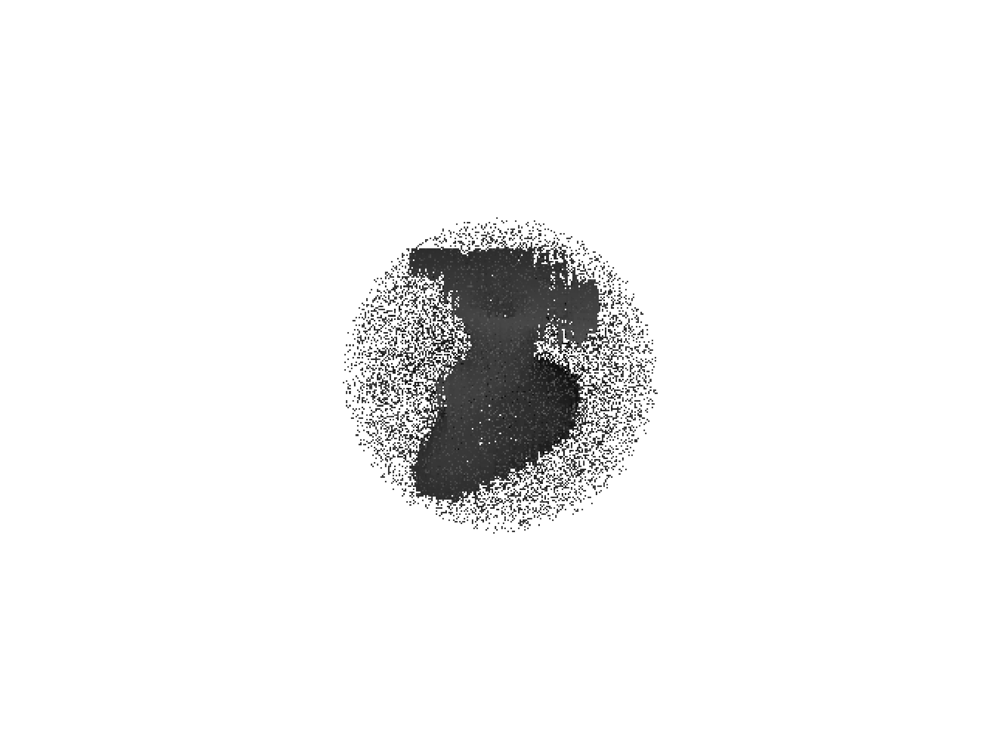

In [62]:
camera = pyrender.PerspectiveCamera(yfov=np.pi / 3.0, aspectRatio=1.0)
s = np.sqrt(6)/2
camera_pose = np.array([
[0.0, -s,   s,   15],
[1.0,  0.0, 0.0, 15],
[0.0,  s,   s,   15],
[0.0,  0.0, 0.0, 1.0],])

import matplotlib.pyplot as plt
from pyrender import RenderFlags
if r: 
    r.delete()
flags = RenderFlags.RGBA | RenderFlags.SHADOWS_DIRECTIONAL
r = pyrender.OffscreenRenderer(viewport_width=640, viewport_height=480, point_size=1.0)
c = scene.add(camera, pose=camera_pose)
color, depth = r.render(scene, flags=flags)
# color
plt.figure(figsize=(35,35))
# plt.subplot(1,2,1)
# plt.axis('off')
# plt.imshow(color)
# plt.subplot(1,2,2)
plt.axis('off')
plt.imshow(depth, cmap=plt.cm.gray_r)
plt.show()



In [69]:
pyrender.Viewer(scene)

ValueError: Unable to initialize an OpenGL 3+ context